In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go
import scipy.linalg as linalg

from european_call_solvers import european_call_fd, european_call_fd_implicit
from european_digital_call_solvers import digital_call_fd_implicit
from american_call_solvers import american_call_fd_implicit
from visualizations import static_visualization, interactive_visualization
from validation import validate_call_at_a_date, validate_digital_call_at_a_date

In [2]:
# Parameters
S_max = 200  # Maximum stock price
T = 4.0      # Time to maturity (1 year)
K = 100      # Strike price
r = 0.05     # Risk-free rate
sigma = 0.2  # Volatility
M = 100      # Stock price number of steps
N = 2000     # Number of time steps

In [3]:
# %%timeit

# Solve the PDE
S, tau, V = european_call_fd_implicit(S_max, T, K, r, sigma, M, N)

In [ ]:
# the resulting value matrix
V

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 1.20327476e-90, 5.78559157e-89, ...,
        7.64141432e-13, 7.71746027e-13, 7.79420749e-13],
       [0.00000000e+00, 1.33721261e-86, 6.29589500e-85, ...,
        8.52511434e-11, 8.60389922e-11, 8.68335316e-11],
       ...,
       [9.60000000e+01, 9.60099990e+01, 9.60199971e+01, ...,
        1.14164960e+02, 1.14173185e+02, 1.14181409e+02],
       [9.80000000e+01, 9.80099991e+01, 9.80199973e+01, ...,
        1.16137384e+02, 1.16145590e+02, 1.16153796e+02],
       [1.00000000e+02, 1.00010000e+02, 1.00019998e+02, ...,
        1.18110548e+02, 1.18118737e+02, 1.18126925e+02]],
      shape=(101, 2001))

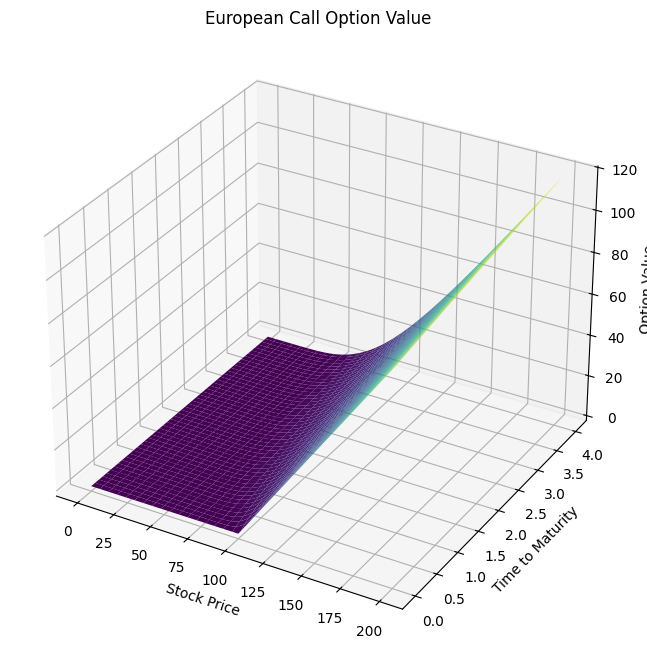

In [5]:
static_visualization(S, tau, V)

In [7]:
# %%timeit

# Solve the PDE
S, tau, V = european_call_fd(S_max, T, K, r, sigma, M, N)

In [8]:
interactive_visualization(S, tau, V)

/workspaces/qa_talks/PDEs/validation.py:6: RuntimeWarning:

divide by zero encountered in log



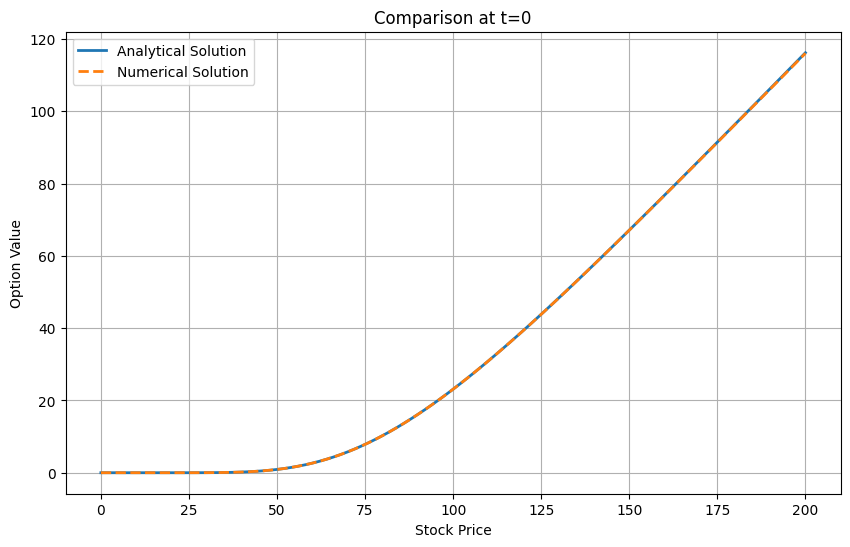

In [9]:
# S, K, T, r, sigma = defined above
# V - numerical solution
# t - at which time to validate
validate_call_at_a_date(S, K, T, r, sigma, V, t = 3.5)

In [10]:
# now, lets price digital option

S_max = 400  # Maximum stock price needs to be increased
S, tau, V = digital_call_fd_implicit(S_max, T, K, r, sigma, M, N)
interactive_visualization(S, tau, V)

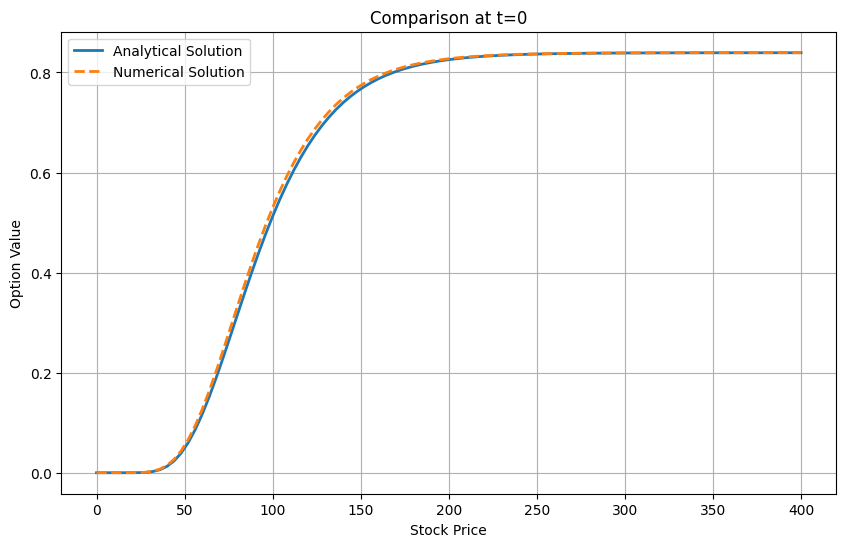

In [11]:
validate_digital_call_at_a_date(S, K, T, r, sigma, V, t = 3.5)

In [12]:
# finally we move to american options

# Parameters
S_max = 400  # Maximum stock price
T = 4.0      # Time to maturity (1 year)
K = 100      # Strike price
r = 0.01     # Risk-free rate
sigma = 0.4  # Volatility
M = 200      # Stock price steps (increase for better accuracy)
N = 1000     # Time steps (increase for better accuracy)

# Solve the PDE
S, tau, V_1 = american_call_fd_implicit(S_max, T, K, r, sigma, M, N)

# Extract the present option value at S=K (interpolate if needed)
option_value_at_K = np.interp(K, S, V_1[:, -1])
print(f"American Call Option Price at S=K: {option_value_at_K:.4f}")

American Call Option Price at S=K: 32.4604


In [13]:
# Solve the PDE
S, tau, V_2 = european_call_fd_implicit(S_max, T, K, r, sigma, M, N)

# Extract the present option value at S=K (interpolate if needed)
option_value_at_K = np.interp(K, S, V_2[:, -1])
print(f"European Call Option Price at S=K: {option_value_at_K:.4f}")

European Call Option Price at S=K: 32.4604


But why the prices are the same...?

Validate the pricing here: https://www.math.columbia.edu/~smirnov/options13.html